In [ ]:
from google.colab import drive

# Mount Google Drive
drive.mount('/content/gdrive', force_remount=True)

# Define root directory for saving trained model results
ROOT_DIR = '/content/gdrive/My Drive/ComputerVisionDeveloper/TrainYolov8CustomDataset'

Mounted at /content/gdrive


In [ ]:
# Install required libraries
!pip install ultralytics roboflow

In [ ]:
# Import necessary libraries
import os
from ultralytics import YOLO
from roboflow import Roboflow
import cv2
import locale

# Set encoding to UTF-8 (to avoid encoding issues in Colab)
locale.getpreferredencoding = lambda: "UTF-8"


In [ ]:
# Initialize Roboflow and download dataset
rf = Roboflow(api_key="mNUL71S5UV9dNnUBJ57y")
project = rf.workspace("testes-luafg").project("persons-rie3b")
version = project.version(1)
dataset = version.download("yolov8-obb")

# Path to the Roboflow dataset configuration file
yaml_path = os.path.join(dataset.location, "data.yaml")


loading Roboflow workspace...
loading Roboflow project...


In [ ]:
# Load a pre-trained YOLOv8 model
model = YOLO("yolov8n.pt")

# Train the YOLOv8 model
epochs = 25  # Adjust the number of epochs as needed
print(f"Training model for {epochs} epochs...")
results = model.train(data=yaml_path, epochs=epochs)


Training model for 25 epochs...
Ultralytics 8.3.47 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/Persons-1/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labe

train: Scanning /content/Persons-1/train/labels.cache... 5199 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5199/5199 [00:00<?, ?it/s]

train: WARNING ⚠️ /content/Persons-1/train/images/0_jpg.rf.efaf7b2b1d00fa1306705e9a0ec1beda.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/Persons-1/train/images/11520_jpg.rf.0f0f1ca2b332a51ad09fab98bde35e08.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/Persons-1/train/images/60480_jpg.rf.3cfe58fde1d0ccc17ff9814d29fb1e66.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/Persons-1/train/images/60480_jpg.rf.b672a9be0dc0120afaec9d3a1bd02966.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/Persons-1/train/images/61920_jpg.rf.62ad92219de469f4ccc9a2588fdb612c.jpg: 1 duplicate labels removed


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


A new version of Albumentations is available: 1.4.22 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
val: Scanning /content/Persons-1/valid/labels.cache... 1488 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1488/1488 [00:00<?, ?it/s]


Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train3
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/25      2.63G      1.652      1.742      1.377        101        640: 100%|██████████| 325/325 [02:07<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:16<00:00,  2.90it/s]


                   all       1488       5519      0.732      0.562      0.653      0.323

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/25      2.48G      1.661       1.49      1.401         95        640: 100%|██████████| 325/325 [02:02<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:14<00:00,  3.27it/s]


                   all       1488       5519      0.744      0.569      0.666      0.347

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/25       2.8G      1.666      1.426      1.411        100        640: 100%|██████████| 325/325 [02:06<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:15<00:00,  3.02it/s]


                   all       1488       5519      0.725      0.565      0.639      0.313

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/25      2.69G      1.625      1.363       1.39         81        640: 100%|██████████| 325/325 [02:04<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:13<00:00,  3.51it/s]


                   all       1488       5519      0.794       0.61      0.711      0.384

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/25      2.66G      1.566      1.287      1.358         80        640: 100%|██████████| 325/325 [02:01<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:15<00:00,  3.06it/s]


                   all       1488       5519      0.805      0.659      0.763      0.422

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/25      2.32G      1.522      1.219      1.329         81        640: 100%|██████████| 325/325 [02:01<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:24<00:00,  1.95it/s]


                   all       1488       5519      0.841      0.696      0.803      0.459

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/25      2.64G      1.491      1.151       1.31         63        640: 100%|██████████| 325/325 [02:05<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:13<00:00,  3.53it/s]


                   all       1488       5519      0.844      0.691      0.792      0.461

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/25      2.47G      1.456      1.117      1.289         76        640: 100%|██████████| 325/325 [02:03<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:15<00:00,  3.07it/s]


                   all       1488       5519      0.842      0.736       0.83      0.484

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/25      2.35G      1.442        1.1      1.282        117        640: 100%|██████████| 325/325 [02:05<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:14<00:00,  3.21it/s]


                   all       1488       5519      0.855       0.74      0.842      0.505

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/25      2.58G      1.414      1.057      1.262         69        640: 100%|██████████| 325/325 [02:03<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:14<00:00,  3.16it/s]


                   all       1488       5519      0.867      0.744      0.845      0.509

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/25      2.59G        1.4      1.027      1.252        117        640: 100%|██████████| 325/325 [02:06<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:15<00:00,  3.03it/s]


                   all       1488       5519      0.863      0.772      0.862      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/25      2.71G      1.382      1.011      1.248         68        640: 100%|██████████| 325/325 [02:03<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:14<00:00,  3.31it/s]


                   all       1488       5519      0.869      0.762      0.856      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/25      2.47G      1.356     0.9759      1.228        132        640: 100%|██████████| 325/325 [02:05<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:14<00:00,  3.18it/s]


                   all       1488       5519       0.87      0.778      0.868      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/25      2.32G      1.327     0.9412      1.208         52        640: 100%|██████████| 325/325 [02:05<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:14<00:00,  3.25it/s]


                   all       1488       5519      0.898       0.79      0.883       0.56

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/25      2.71G      1.319     0.9241      1.206         83        640: 100%|██████████| 325/325 [01:59<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:15<00:00,  3.09it/s]


                   all       1488       5519      0.879      0.799      0.886      0.555
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/25      2.71G      1.256     0.8102       1.18         41        640: 100%|██████████| 325/325 [01:48<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:15<00:00,  3.09it/s]


                   all       1488       5519      0.889      0.797      0.888      0.567

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/25      2.46G      1.237      0.788      1.171         49        640: 100%|██████████| 325/325 [01:41<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:15<00:00,  3.09it/s]

                   all       1488       5519       0.91      0.812      0.902       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/25      2.64G      1.213     0.7527      1.153         46        640: 100%|██████████| 325/325 [01:46<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:13<00:00,  3.46it/s]

                   all       1488       5519      0.909      0.812      0.902      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/25      2.78G        1.2     0.7393      1.145         65        640: 100%|██████████| 325/325 [01:44<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:15<00:00,  3.03it/s]


                   all       1488       5519      0.906      0.823      0.909      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/25      2.46G      1.169     0.7136      1.132         52        640: 100%|██████████| 325/325 [01:43<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:15<00:00,  3.12it/s]


                   all       1488       5519      0.909      0.828      0.913      0.606

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/25      2.53G      1.151     0.6938      1.119         43        640: 100%|██████████| 325/325 [01:46<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:13<00:00,  3.52it/s]

                   all       1488       5519      0.909      0.825      0.913      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/25      2.59G      1.134     0.6769      1.115         41        640: 100%|██████████| 325/325 [01:44<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:15<00:00,  3.07it/s]

                   all       1488       5519      0.909      0.843      0.921       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/25       2.3G      1.113     0.6595      1.102         59        640: 100%|██████████| 325/325 [01:40<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:14<00:00,  3.16it/s]

                   all       1488       5519      0.908      0.844      0.923      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/25      2.41G      1.095     0.6411      1.098         46        640: 100%|██████████| 325/325 [01:45<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:12<00:00,  3.76it/s]

                   all       1488       5519      0.912      0.846      0.923      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/25       2.5G      1.073     0.6249      1.083         37        640: 100%|██████████| 325/325 [01:45<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:15<00:00,  3.08it/s]


                   all       1488       5519      0.913      0.856      0.927      0.633

25 epochs completed in 0.921 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 6.2MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics 8.3.47 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:17<00:00,  2.69it/s]


                   all       1488       5519      0.913      0.856      0.927      0.633
Speed: 0.3ms preprocess, 2.2ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to runs/detect/train3


In [ ]:
# Save training results back to Google Drive
trained_model_dir = '/content/runs'
target_dir = f'/content/gdrive/My Drive/ComputerVisionDeveloper/TrainYolov8CustomDataset'
!scp -r {trained_model_dir} {target_dir}
print(f"Training results saved to: {target_dir}")


Drive/ComputerVisionDeveloper/TrainYolov8CustomDataset: No such file or directory
Training results saved to: /content/gdrive/My Drive/ComputerVisionDeveloper/TrainYolov8CustomDataset


Running inference...

0: 448x640 20 persons, 43.7ms
Speed: 2.3ms preprocess, 43.7ms inference, 8.2ms postprocess per image at shape (1, 3, 448, 640)
Processed image saved at: ./images/out.jpg


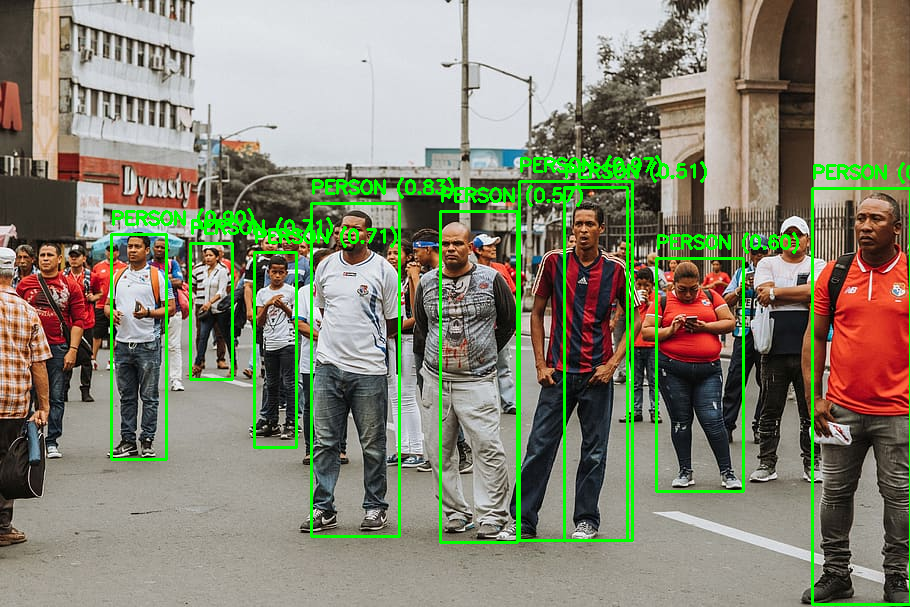

In [ ]:
# Define paths for input and output images
IMAGES_DIR = os.path.join('.', 'images')
os.makedirs(IMAGES_DIR, exist_ok=True)  # Ensure the images directory exists
input_image_path = os.path.join(IMAGES_DIR, 'inp.jpg')  # Replace with your input image name
output_image_path = os.path.join(IMAGES_DIR, 'out.jpg')

# Load the input image
image = cv2.imread(input_image_path)
if image is None:
    print(f"Error: Could not read the image at {input_image_path}")
else:
    # Load the custom-trained YOLO model
    trained_model_path = os.path.join(trained_model_dir, 'detect', 'train', 'weights', 'last.pt')
    model = YOLO(trained_model_path)

    # Set detection threshold
    detection_threshold = 0.5

    # Perform inference
    print("Running inference...")
    results = model(image)[0]

    # Process results and draw bounding boxes
    for result in results.boxes.data.tolist():
        x1, y1, x2, y2, score, class_id = result
        if score > detection_threshold:
            # Draw bounding box and label
            cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
            label = f"{results.names[int(class_id)].upper()} ({score:.2f})"
            cv2.putText(image, label, (int(x1), int(y1 - 10)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

    # Save and display processed image
    cv2.imwrite(output_image_path, image)
    print(f"Processed image saved at: {output_image_path}")
    from google.colab.patches import cv2_imshow
    cv2_imshow(image)  # Display the image in Colab

# Release resources
cv2.destroyAllWindows()


In [ ]:
import os
from ultralytics import YOLO
import cv2

# Define the input and output video paths
VIDEO_DIR = os.path.join('.', 'videos')  # Use relative paths
os.makedirs(VIDEO_DIR, exist_ok=True)  # Ensure the videos directory exists

video_path = os.path.join(VIDEO_DIR, 'testrel.mp4')  # Input video path (replace with your video file)
output_video_path = os.path.join(VIDEO_DIR, 'test_video_out.mp4')  # Output video path

# Load the video
cap = cv2.VideoCapture(video_path)
if not cap.isOpened():
    print(f"Error: Could not open video at {video_path}")
    exit()

# Load the trained YOLO model
trained_model_path = os.path.join('.', 'runs', 'detect', 'train', 'weights', 'last.pt')  # Relative path to the model weights
model = YOLO(trained_model_path)  # Load the custom-trained model

# Set the detection threshold
detection_threshold = 0.5

# Get video properties for output
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec for MP4

# Create VideoWriter object
out = cv2.VideoWriter(output_video_path, fourcc, fps, (frame_width, frame_height))

# Process each frame
print("Processing video...")
while True:
    ret, frame = cap.read()
    if not ret:
        break  # Break when no frames are left

    # Perform inference on the current frame
    results = model(frame)[0]

    # Process the results and draw bounding boxes
    for result in results.boxes.data.tolist():
        x1, y1, x2, y2, score, class_id = result
        if score > detection_threshold:
            # Draw bounding box and label
            cv2.rectangle(frame, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
            label = f"{results.names[int(class_id)].upper()} ({score:.2f})"
            cv2.putText(frame, label, (int(x1), int(y1 - 10)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

    # Write the processed frame to the output video
    out.write(frame)

# Release resources
cap.release()
out.release()
cv2.destroyAllWindows()

print(f"Processed video saved as {output_video_path}")


In [ ]:
from IPython.display import HTML
from base64 import b64encode

# Function to display video in Colab
def display_video(video_path, width=640):
    # Encode video to base64
    with open(video_path, "rb") as video_file:
        video_data = video_file.read()
    video_url = f"data:video/mp4;base64,{b64encode(video_data).decode()}"
    return HTML(f"""
        <video width="{width}" controls>
            <source src="{video_url}" type="video/mp4">
        </video>
    """)

# Path to the processed video
processed_video_path = os.path.join('.', 'videos', 'test_video_out.mp4')

# Display the video
display_video(processed_video_path)